In [1]:
import os
from tqdm.notebook import tqdm
import json

import torch
from torch_geometric.data import Data
from torch_geometric.loader import DataLoader
import torch.nn.functional as F

import numpy as np
from sklearn.metrics import confusion_matrix, classification_report
from sklearn.preprocessing import RobustScaler, MinMaxScaler

from rdkit import Chem
from rdkit.Chem import Draw

import json
import networkx as nx
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

from src.utils import create_edge_index, PLIDataset, set_all_seeds, GCN, GNN7L_Sage, GNN7L_GAT, save_model, GNN7L_GraphConv
from src.edgeshaper import Edgeshaper

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [2]:
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

In [3]:
DATA_PATH = 'data/pdbbind/dataset/'
SAVE_FOLDER = 'results/explanations/'
CLASSIFICATION = False
TRAIN = False
CORRECT = False

CLEAN_DATA = True
MIN_AFFINITY = 5
MAX_AFFINITY = 11
NUM_CLASSES = 1
CLASS_THRESHOLD = 7

# AFFINITY_GROUP = "low" #mean is from 6.5 to 7.5 extremes included, low is below 6 and high is above 8.
MEAN_LOWER_BOUND = 6.5
MEAN_UPPER_BOUND = 7.5
LOW_BOUND = 6
HIGH_BOUND = 8

MODEL_NAME = "GNN7L_GAT" # "GNN7L_GraphConv" GCN GNN7L_Sage GNN7L_GAT
GNN = GNN7L_GAT # GNN7L_GraphConv
MODEL_VERSION = "best_98" # "best_94=GraphConv_regre_unweigthed" "best_90=graph_conv_class_weighted" #best_86=graph_conv_class_UNweighted, best_memo_98 best_memo_97 best_72=GCN_regr_unweighted best_89=GraphConv_regr_weighted
STATISTICS_FOLDER = None #"results/explanations/regression/20 samples GAT weighted correct predictions/"

EDGE_WEIGHT = True
if MODEL_NAME == "GNN7L_Sage": EDGE_WEIGHT = False
SCALING = True

SEED = 42
HIDDEN_CHANNELS = 256
EPOCHS = 100
NODE_FEATURES = True #if True, Volkov features are used, if False, use dummy features (1)

set_all_seeds(42)

if CLASSIFICATION:
    NUM_CLASSES = 2

## Load dataset

#### Load affinities
Already save in JSON, can load them

In [4]:
interaction_affinities = None

with open(DATA_PATH + '/interaction_affinities.json', 'r') as fp:
    interaction_affinities = json.load(fp)

In [5]:
vals = list(interaction_affinities.values())
mean_interaction_affinity = np.mean(vals)
mean_interaction_affinity

6.395088287020752

(array([  4.,   1.,   3.,   0.,   7.,   3.,  12.,  11.,  18.,  19.,  31.,
         34.,  69.,  48.,  50.,  76.,  82., 147., 102., 162., 136., 183.,
        190., 164., 252., 223., 249., 269., 277., 331., 269., 353., 326.,
        353., 286., 349., 342., 409., 372., 425., 398., 432., 460., 407.,
        337., 428., 422., 434., 425., 450., 334., 464., 326., 357., 267.,
        154., 282., 135., 239., 128., 140.,  86.,  74.,  49.,  71.,  29.,
         30.,  22.,  35.,  21.,  22.,  23.,  10.,  27.,   6.,  10.,   9.,
          6.,   9.,   1.,   5.,   0.,   2.,   1.,   0.,   5.,   0.,   1.,
          0.,   0.,   0.,   1.,   0.,   0.,   1.,   0.,   0.,   0.,   2.,
          1.]),
 array([ 0.4   ,  0.5482,  0.6964,  0.8446,  0.9928,  1.141 ,  1.2892,
         1.4374,  1.5856,  1.7338,  1.882 ,  2.0302,  2.1784,  2.3266,
         2.4748,  2.623 ,  2.7712,  2.9194,  3.0676,  3.2158,  3.364 ,
         3.5122,  3.6604,  3.8086,  3.9568,  4.105 ,  4.2532,  4.4014,
         4.5496,  4.6978,  4.846 ,

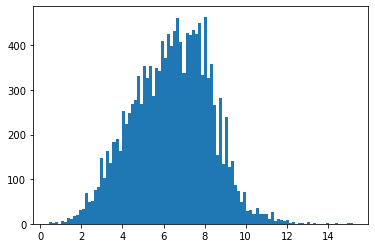

In [6]:
# min(vals), max(vals)
%matplotlib inline
plt.hist(vals, bins=100)

### remove outliers

In [7]:
affinities_df = pd.DataFrame.from_dict(interaction_affinities, orient='index', columns=['affinity'])

if CLEAN_DATA == True:
    affinities_df = affinities_df[affinities_df['affinity'] >= MIN_AFFINITY]
    affinities_df = affinities_df[affinities_df['affinity'] <= MAX_AFFINITY]

vals_cleaned = list(affinities_df['affinity'])
mean_interaction_affinity_no_outliers = np.mean(vals_cleaned)
mean_interaction_affinity_no_outliers

7.149117619537756

In [8]:
print("Number of weak interactions: ", len(affinities_df[affinities_df['affinity'] <= CLASS_THRESHOLD ]))
print("Number of strong interactions: ", len(affinities_df[affinities_df['affinity'] > CLASS_THRESHOLD ]))

Number of weak interactions:  5117
Number of strong interactions:  5570


In [9]:
affinities_df = affinities_df.sort_values(by = "affinity", ascending=True)

# pseudo_labels = pd.qcut(x = affinities_df["affinity"], q = NUM_CLASSES, labels = [i for i in range(NUM_CLASSES)])
pseudo_labels = [0 if x <= CLASS_THRESHOLD else 1 for x in affinities_df["affinity"]]
affinities_df["pseudo_label"] = pseudo_labels
interaction_affinities = affinities_df.to_dict(orient='index')
interaction_affinities

{'1pip': {'affinity': 5.0, 'pseudo_label': 0},
 '5lj2': {'affinity': 5.0, 'pseudo_label': 0},
 '5lpj': {'affinity': 5.0, 'pseudo_label': 0},
 '1nnb': {'affinity': 5.0, 'pseudo_label': 0},
 '3vbv': {'affinity': 5.0, 'pseudo_label': 0},
 '3uqg': {'affinity': 5.0, 'pseudo_label': 0},
 '5myl': {'affinity': 5.0, 'pseudo_label': 0},
 '3uii': {'affinity': 5.0, 'pseudo_label': 0},
 '5nq5': {'affinity': 5.0, 'pseudo_label': 0},
 '5o3r': {'affinity': 5.0, 'pseudo_label': 0},
 '1kr3': {'affinity': 5.0, 'pseudo_label': 0},
 '1jpl': {'affinity': 5.0, 'pseudo_label': 0},
 '1jm4': {'affinity': 5.0, 'pseudo_label': 0},
 '1inf': {'affinity': 5.0, 'pseudo_label': 0},
 '1ih0': {'affinity': 5.0, 'pseudo_label': 0},
 '1i6v': {'affinity': 5.0, 'pseudo_label': 0},
 '1hqf': {'affinity': 5.0, 'pseudo_label': 0},
 '1hlk': {'affinity': 5.0, 'pseudo_label': 0},
 '3ezr': {'affinity': 5.0, 'pseudo_label': 0},
 '6bto': {'affinity': 5.0, 'pseudo_label': 0},
 '3new': {'affinity': 5.0, 'pseudo_label': 0},
 '3dvp': {'af

In [10]:
descriptors_interaction_dict = None
num_node_features = 0
if NODE_FEATURES:
    descriptors_interaction_dict = {}
    descriptors_interaction_dict["CA"] = [1, 0, 0, 0, 0, 0, 0, 0]
    descriptors_interaction_dict["NZ"] = [0, 1, 0, 0, 0, 0, 0, 0]
    descriptors_interaction_dict["N"] = [0, 0, 1, 0, 0, 0, 0, 0]
    descriptors_interaction_dict["OG"] = [0, 0, 0, 1, 0, 0, 0, 0]
    descriptors_interaction_dict["O"] = [0, 0, 0, 0, 1, 0, 0, 0]
    descriptors_interaction_dict["CZ"] = [0, 0, 0, 0, 0, 1, 0, 0]
    descriptors_interaction_dict["OD1"] = [0, 0, 0, 0, 0, 0, 1, 0]
    descriptors_interaction_dict["ZN"] = [0, 0, 0, 0, 0, 0, 0, 1]
    num_node_features = len(descriptors_interaction_dict["CA"])

In [11]:
def generate_pli_dataset_dict(data_path):

    directory = os.fsencode(data_path)

    dataset_dict = {}
    dirs = os.listdir(directory)
    for file in tqdm(dirs):
        interaction_name = os.fsdecode(file)

        if interaction_name in interaction_affinities:
            if os.path.isdir(data_path + interaction_name):
                dataset_dict[interaction_name] = {}
                G = None
                with open(data_path + interaction_name + "/" + interaction_name + "_interaction_graph.json", 'r') as f:
                    data = json.load(f)
                    G = nx.Graph()

                    for node in data['nodes']:
                        G.add_node(node["id"], atom_type=node["attype"], origin=node["pl"]) #are we supposed to add nodes with no edges?

                    for edge in data['edges']:
                        if edge["id1"] != None and edge["id2"] != None:
                            G.add_edge(edge["id1"], edge["id2"], weight= float(edge["length"]))
                            
                            #add node attributes this way an not in the loop below
                            # G.add_node(edge["id1"], atom_type=data['nodes'][edge["id1"]]["attype"], origin = data['nodes'][edge["id1"]]["pl"])
                            # G.add_node(edge["id2"], atom_type=data['nodes'][edge["id2"]]["attype"], origin = data['nodes'][edge["id2"]]["pl"])

                    for node in data['nodes']:
                        nx.set_node_attributes(G, {node["id"]: node["attype"]}, "atom_type")
                        nx.set_node_attributes(G, {node["id"]: node["pl"]}, "origin")

                    # print(nx.to_scipy_sparse_matrix(G).tocoo())
                    
                dataset_dict[interaction_name]["networkx_graph"] = G
                edge_index, edge_weight = create_edge_index(G, weighted=True)

                dataset_dict[interaction_name]["edge_index"] = edge_index
                dataset_dict[interaction_name]["edge_weight"] = edge_weight
                

                num_nodes = G.number_of_nodes()
                # print("Number of nodes: ", num_nodes)
                # print("interaction_name: ", interaction_name)
                # print("nodes: ", G.nodes)
                # print("len nodes: ", len(G.nodes))
                if not NODE_FEATURES:
                    dataset_dict[interaction_name]["x"] = torch.full((num_nodes, 1), 1.0, dtype=torch.float) #dummy feature
                else:
                    dataset_dict[interaction_name]["x"] = torch.zeros((num_nodes, num_node_features), dtype=torch.float)
                    for node in G.nodes:
                        # print(node)
                        # print(G.nodes[node]["atom_type"])
                        # print(interaction_name)
                        dataset_dict[interaction_name]["x"][node] = torch.tensor(descriptors_interaction_dict[G.nodes[node]["atom_type"]], dtype=torch.float)
                    print(dataset_dict[interaction_name]["x"])

                ## gather label
                dataset_dict[interaction_name]["y"] = torch.FloatTensor([interaction_affinities[interaction_name]["affinity"]])

                ## gather pseudo label
                dataset_dict[interaction_name]["pseudo_label"] = torch.LongTensor([interaction_affinities[interaction_name]["pseudo_label"]])
    
    return dataset_dict
        
pli_dataset_dict = generate_pli_dataset_dict(DATA_PATH)

  0%|          | 0/14219 [00:00<?, ?it/s]

tensor([[0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 1., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0., 0.],
        [1., 0., 0., 0., 0., 0., 0

In [12]:
pli_dataset_dict

{'10gs': {'networkx_graph': <networkx.classes.graph.Graph at 0x17c4015efd0>,
  'edge_index': tensor([[ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,
            1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,
            3,  3,  3,  4,  4,  4,  4,  4,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,
            6,  6,  6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,
            8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 10, 11,
           11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 13, 14, 14,
           14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
           15, 15, 15, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17,
           17, 17, 17, 18, 18, 18, 18, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 19,
           19, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20, 21, 21, 21, 21, 21, 21,
           22, 22, 22, 22, 22, 22, 23, 23, 23, 23, 23, 23, 23, 24, 24, 24, 24, 

### create torch dataset

In [13]:
if SCALING:
    first_level = [pli_dataset_dict[key]["edge_weight"] for key in pli_dataset_dict]
    second_level = [item for sublist in first_level for item in sublist]
    if MODEL_NAME == "GCN":
        transformer = MinMaxScaler().fit(np.array(second_level).reshape(-1, 1))
    else:
        transformer = RobustScaler().fit(np.array(second_level).reshape(-1, 1))
    for key in tqdm(pli_dataset_dict):
        scaled_weights = transformer.transform(np.array(pli_dataset_dict[key]["edge_weight"]).reshape(-1, 1))
        scaled_weights = [x[0] for x in scaled_weights]
        pli_dataset_dict[key]["edge_weight"] = torch.FloatTensor(scaled_weights)
        
data_list = []
for interaction_name in tqdm(pli_dataset_dict):
    edge_weight_sample = None
    if EDGE_WEIGHT:
        edge_weight_sample = pli_dataset_dict[interaction_name]["edge_weight"]
    data_list.append(Data(x = pli_dataset_dict[interaction_name]["x"], edge_index = pli_dataset_dict[interaction_name]["edge_index"], edge_weight = edge_weight_sample, y = pli_dataset_dict[interaction_name]["y"], pseudo_label=pli_dataset_dict[interaction_name]["pseudo_label"], networkx_graph = pli_dataset_dict[interaction_name]["networkx_graph"], interaction_name = interaction_name))

  0%|          | 0/10687 [00:00<?, ?it/s]

  0%|          | 0/10687 [00:00<?, ?it/s]

In [14]:
pli_dataset_dict

{'10gs': {'networkx_graph': <networkx.classes.graph.Graph at 0x17c4015efd0>,
  'edge_index': tensor([[ 0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  0,  1,  1,  1,  1,  1,
            1,  1,  1,  1,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  2,  3,  3,
            3,  3,  3,  4,  4,  4,  4,  4,  5,  5,  5,  5,  5,  5,  6,  6,  6,  6,
            6,  6,  6,  6,  6,  6,  7,  7,  7,  7,  7,  7,  7,  8,  8,  8,  8,  8,
            8,  8,  8,  8,  8,  8,  9,  9,  9,  9,  9,  9, 10, 10, 10, 10, 10, 11,
           11, 11, 11, 11, 12, 12, 12, 12, 12, 12, 13, 13, 13, 13, 13, 13, 14, 14,
           14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
           15, 15, 15, 16, 16, 16, 16, 16, 16, 16, 16, 16, 16, 17, 17, 17, 17, 17,
           17, 17, 17, 18, 18, 18, 18, 18, 18, 18, 18, 18, 19, 19, 19, 19, 19, 19,
           19, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20, 20, 21, 21, 21, 21, 21, 21,
           22, 22, 22, 22, 22, 22, 23, 23, 23, 23, 23, 23, 23, 24, 24, 24, 24, 

In [15]:
dataset = PLIDataset(".", data_list = data_list)

In [16]:
train_interactions = []
val_interactions = []
core_set_interactions = []
hold_out_interactions = []

with open("data/pdbbind/pdb_ids/training_set.csv", 'r') as f:
    train_interactions = f.readlines()

train_interactions = [interaction.strip() for interaction in train_interactions]

with open("data/pdbbind/pdb_ids/validation_set.csv", 'r') as f:
    val_interactions = f.readlines()

val_interactions = [interaction.strip() for interaction in val_interactions]

with open("data/pdbbind/pdb_ids/core_set.csv", 'r') as f:
    core_set_interactions = f.readlines()

core_set_interactions = [interaction.strip() for interaction in core_set_interactions]

with open("data/pdbbind/pdb_ids/hold_out_set.csv", 'r') as f:
    hold_out_interactions = f.readlines()

hold_out_interactions = [interaction.strip() for interaction in hold_out_interactions]

In [17]:
train_data = [dataset[i] for i in range(len(dataset)) if dataset[i].interaction_name in train_interactions]
val_data = [dataset[i] for i in range(len(dataset)) if dataset[i].interaction_name in val_interactions]
core_set_data = [dataset[i] for i in range(len(dataset)) if dataset[i].interaction_name in core_set_interactions]
hold_out_data = [dataset[i] for i in range(len(dataset)) if dataset[i].interaction_name in hold_out_interactions]

test_data = core_set_data + hold_out_data
#data for specific affinity ranges
low_affinity_hold_out_data = [hold_out_data[i] for i in range(len(hold_out_data)) if hold_out_data[i].y < LOW_BOUND]
high_affinity_hold_out_data = [hold_out_data[i] for i in range(len(hold_out_data)) if hold_out_data[i].y > HIGH_BOUND]
medium_affinity_hold_out_data = [hold_out_data[i] for i in range(len(hold_out_data)) if (hold_out_data[i].y >= MEAN_LOWER_BOUND and hold_out_data[i].y <= MEAN_UPPER_BOUND)]

low_affinity_data = [test_data[i] for i in range(len(test_data)) if test_data[i].y < LOW_BOUND]
high_affinity_data = [test_data[i] for i in range(len(test_data)) if test_data[i].y > HIGH_BOUND]
medium_affinity_data = [test_data[i] for i in range(len(test_data)) if (test_data[i].y >= MEAN_LOWER_BOUND and test_data[i].y <= MEAN_UPPER_BOUND)]

low_affinity_data = low_affinity_hold_out_data
high_affinity_data = high_affinity_hold_out_data
medium_affinity_data = medium_affinity_hold_out_data
#alternative here is to comment the shuffle out and use shuffling in the dataloader
rng = np.random.default_rng(seed = SEED)
rng.shuffle(train_data)
rng.shuffle(val_data)
rng.shuffle(core_set_data)
rng.shuffle(hold_out_data)

rng.shuffle(low_affinity_data)
rng.shuffle(high_affinity_data)
rng.shuffle(medium_affinity_data)

In [18]:
BATCH_SIZE = 32

train_loader = DataLoader(train_data, batch_size=BATCH_SIZE)
val_loader = DataLoader(val_data, batch_size=BATCH_SIZE)
core_set_loader = DataLoader(core_set_data, batch_size=BATCH_SIZE)
hold_out_loader = DataLoader(hold_out_data, batch_size=BATCH_SIZE)

low_affinity_loader = DataLoader(low_affinity_data, batch_size=BATCH_SIZE)
high_affinity_loader = DataLoader(high_affinity_data, batch_size=BATCH_SIZE)
medium_affinity_loader = DataLoader(medium_affinity_data, batch_size=BATCH_SIZE)

In [19]:
print(len(low_affinity_loader.dataset))
print(len(low_affinity_loader))

533
17


### Train the network

In [20]:
#training the network #GCN, GNN7L_Sage, GNN7L_GraphConv
model = GNN(node_features_dim = dataset[0].x.shape[1], num_classes = NUM_CLASSES, hidden_channels=HIDDEN_CHANNELS).to(device)

lr = 1e-3

optimizer = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=5e-4)
# scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.7, patience=10, min_lr=1e-6, verbose=True)

if CLASSIFICATION:
    criterion = torch.nn.CrossEntropyLoss()
    # criterion = torch.nn.BCEWithLogitsLoss()
else:
    criterion = torch.nn.MSELoss()
    
epochs = EPOCHS

In [21]:
def train():
    model.train()

    for data in train_loader:  # Iterate in batches over the training dataset.
        data = data.to(device)
        out = model(data.x, data.edge_index, data.batch, edge_weight = data.edge_weight)  # Perform a single forward pass.
        # print(out)
        # print(data.y)
        loss = torch.sqrt(criterion(torch.squeeze(out), data.y))  # Compute the loss.
        # scheduler.step(loss)
        loss.backward()  # Derive gradients.
        optimizer.step()  # Update parameters based on gradients.
        optimizer.zero_grad()  # Clear gradients.

def test(loader):
    model.eval()
    predictions = []
    sum_loss = 0
    for data in loader:  # Iterate in batches over the training/test dataset.
        data = data.to(device)
        
        out = model(data.x, data.edge_index, data.batch, edge_weight = data.edge_weight)
        predictions += [elem[0] for elem in out.tolist()]
        if  data.y.shape[0] == 1:
            loss = torch.sqrt(criterion(torch.squeeze(out, 1), data.y))
        else:
            loss = torch.sqrt(criterion(torch.squeeze(out), data.y)) * data.y.shape[0]
        sum_loss += loss.item()
        
        # print(out)
    return sum_loss / len(loader.dataset), predictions  # Derive ratio of correct predictions.
    # return sum_loss / len(loader), predictions  # Derive ratio of correct predictions.

In [22]:
# for data in hold_out_loader:  # Iter
#     print(data)

In [23]:
def train_classification():
    model.train()

    for data in train_loader:  # Iterate in batches over the training dataset.
        data = data.to(device)
        out = model(data.x, data.edge_index, data.batch, edge_weight = data.edge_weight)  # Perform a single forward pass.
        # print(out)
        # print(data.pseudo_label)
        loss = criterion(out, data.pseudo_label)
        # loss = criterion(torch.squeeze(out), torch.FloatTensor(data.pseudo_label.tolist()).to(device))  # Compute the loss.
        # scheduler.step(loss)
        loss.backward()  # Derive gradients.
        optimizer.step()  # Update parameters based on gradients.
        optimizer.zero_grad()  # Clear gradients.

def test_classification(loader):
    model.eval()
    predictions = []
    correct = 0
    for data in loader:  # Iterate in batches over the training/test dataset.
        data = data.to(device)
        
        out = model(data.x, data.edge_index, data.batch, edge_weight = data.edge_weight)  
        pred = out.argmax(dim=1)  # Use the class with highest probability.
        predictions += pred.tolist()
        correct += int((pred == data.pseudo_label).sum())  # Check against ground-truth labels.
    return correct / len(loader.dataset), predictions  # Derive ratio of correct predictions.

To train network, uncomment the cell below

In [24]:
best_epoch = 0

if TRAIN:
    if not CLASSIFICATION:
        best_val_loss = 100000
        for epoch in range(epochs):
            train()
            train_rmse = test(train_loader)
            val_rmse = test(val_loader)
            if val_rmse < best_val_loss:
                best_val_loss = val_rmse
                best_epoch = epoch
                save_model(model, "models", model_name = MODEL_NAME + "_best")
                
            print(f'Epoch: {epoch:03d}, Train RMSE: {train_rmse:.4f}, Val RMSE: {val_rmse:.4f}')

        core_set_rmse, _ = test(core_set_loader)    
        print(f'Core set 2016 RMSE with latest model: {core_set_rmse:.4f}')

        hold_out_set_rmse, _ = test(hold_out_loader)    
        print(f'Hold out set 2019 RMSE with latest model: {hold_out_set_rmse:.4f}')

        save_model(model, "models", model_name = MODEL_NAME + "_latest")

    else:
        best_val_acc = 0
        for epoch in range(epochs):
            train_classification()
            train_acc, _ = test_classification(train_loader)
            val_acc, _ = test_classification(val_loader)
            if val_acc > best_val_acc:
                best_val_acc = val_acc
                best_epoch = epoch
                save_model(model, "models_classification", model_name = MODEL_NAME + "_best")

            print(f'Epoch: {epoch:03d}, Train Accuracy: {train_acc:.4f}, Val Accuracy: {val_acc:.4f}')

        core_set_acc, _ = test_classification(core_set_loader)    
        print(f'Core set 2016 Accuracy with latest model: {core_set_acc:.4f}')

        hold_out_set_acc, _ = test_classification(hold_out_loader)    
        print(f'Hold out set 2019 Accuracy with latest model: {hold_out_set_acc:.4f}')

        save_model(model, "models_classification", model_name = MODEL_NAME + "_latest")

    print(f'Best model at epoch: {best_epoch:03d}')
    
    if CLASSIFICATION:
        print("Best val acc: ", best_val_acc)
    else:
        print("Best val loss: ", best_val_loss)   
else:
    if not CLASSIFICATION:
        model.load_state_dict(torch.load("models/model_" + MODEL_NAME + "_" + MODEL_VERSION + ".ckpt")) #model_2022_11_08-15_47_33
        model.to(device)
        model
    else:
        model.load_state_dict(torch.load("models_classification/model_" + MODEL_NAME + "_" + MODEL_VERSION + ".ckpt"))
        model.to(device)
        model

In [25]:
if TRAIN:
    model = GNN(node_features_dim = dataset[0].x.shape[1], num_classes = NUM_CLASSES, hidden_channels=HIDDEN_CHANNELS).to(device)
    if CLASSIFICATION:
        model.load_state_dict(torch.load("models_classification/model_" + MODEL_NAME + "_best.ckpt"))
    else:
        model.load_state_dict(torch.load("models/model_" + MODEL_NAME + "_best.ckpt"))
    model.to(device)
    model

In [26]:
%matplotlib inline

if not CLASSIFICATION:
    core_set_rmse, preds = test(core_set_loader)
    # print(preds)

    avg_pred_affinity = sum(preds) / len(preds)    
    print(f'Core set 2016 RMSE with best model: {core_set_rmse:.4f}')
    print(f'Core set 2016 avg predicted affinity: {avg_pred_affinity:.4f}')

else:
    core_set_acc, predictions = test_classification(core_set_loader)    
    print(f'Core set 2016 Accuracy with best model: {core_set_acc:.4f}')

    actual_labels = []
    for data in core_set_loader:
        actual_labels += data.pseudo_label.tolist()

    print(classification_report(actual_labels, predictions))
    cm = confusion_matrix(actual_labels, predictions, normalize='true')
    plt.figure(figsize=(9,9))
    # labels = ["strong", "mild", "weak"]
    sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'Blues') #, xticklabels = labels, yticklabels = labels


Core set 2016 RMSE with best model: 1.3207
Core set 2016 avg predicted affinity: 7.2209


In [27]:
%matplotlib inline
if not CLASSIFICATION:
    hold_out_set_rmse, preds = test(hold_out_loader)
    avg_pred_affinity = sum(preds) / len(preds)    
    print(f'Hold out set 2019 RMSE with best model: {hold_out_set_rmse:.4f}')
    print(f'Hold out set 2019 avg predicted affinity: {avg_pred_affinity:.4f}')
else:
    hold_out_set_acc, predictions = test_classification(hold_out_loader)    
    print(f'Hold out set 2019 Accuracy with best model: {hold_out_set_acc:.4f}')

    actual_labels = []
    for data in hold_out_loader:
        actual_labels += data.pseudo_label.tolist()
    
    print(classification_report(actual_labels, predictions))
    cm = confusion_matrix(actual_labels, predictions, normalize='true')
    plt.figure(figsize=(9,9))
    # labels = ["strong", "mild", "weak"]
    sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'Blues') #xticklabels = labels, yticklabels = labels

Hold out set 2019 RMSE with best model: 1.1664
Hold out set 2019 avg predicted affinity: 7.2321


In [28]:
low_test_data= []
medium_test_data = []
high_test_data = []

if CORRECT:
    for aff in ["low", "medium", "high"]:
        directory = STATISTICS_FOLDER + aff + " affinity/"
        for file in tqdm(os.listdir(directory)):
            test_interaction_name = os.fsdecode(file)
            # if test_interaction_name != SELECTED_INTERACTION_NAME:
            #     continue
            # print(test_interaction_name)
            
            test_interaction_path = directory + test_interaction_name
            if os.path.isdir(test_interaction_path):
                for i, interaction in enumerate(hold_out_data):
                    if interaction.interaction_name == test_interaction_name:
                        test_interaction_index = i
                        break
            else:
                continue
            
            if aff == "low":
                low_test_data.append(hold_out_data[test_interaction_index])
            elif aff == "medium":
                medium_test_data.append(hold_out_data[test_interaction_index])
            else:
                high_test_data.append(hold_out_data[test_interaction_index])

    low_affinity_loader = DataLoader(low_test_data)
    medium_affinity_loader = DataLoader(medium_test_data)
    high_affinity_loader = DataLoader(high_test_data)
    

In [29]:
# for data in low_affinity_loader:
#     print(data)

Low affinity

In [30]:
%matplotlib inline
if not CLASSIFICATION:
    low_affinity_rmse, preds = test(low_affinity_loader)
    avg_pred_affinity = sum(preds) / len(preds)    
    print(f'Low Affinity RMSE with best model: {low_affinity_rmse:.4f}')
    print(f'Low Affinity avg predicted affinity: {avg_pred_affinity:.4f}')
else:
    low_affinity_accuracy, predictions = test_classification(low_affinity_loader)    
    print(f'Low Affinity Accuracy with best model: {low_affinity_accuracy:.4f}')

    actual_labels = []
    for data in low_affinity_loader:
        actual_labels += data.pseudo_label.tolist()
    
    print(classification_report(actual_labels, predictions))
    cm = confusion_matrix(actual_labels, predictions, normalize='true')
    plt.figure(figsize=(9,9))
    # labels = ["strong", "mild", "weak"]
    sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'Blues') #xticklabels = labels, yticklabels = labels

Low Affinity RMSE with best model: 1.5696
Low Affinity avg predicted affinity: 7.0010


Medium Affinity

In [31]:
%matplotlib inline
if not CLASSIFICATION:
    medium_affinity_rmse, preds = test(medium_affinity_loader)    
    avg_pred_affinity = sum(preds) / len(preds)
    print(f'Medium Affinity RMSE with best model: {medium_affinity_rmse:.4f}')
    print(f'Medium Affinity avg predicted affinity: {avg_pred_affinity:.4f}')
else:
    medium_affinity_accuracy, predictions = test_classification(medium_affinity_loader)    
    print(f'Medium Affinity Accuracy with best model: {medium_affinity_accuracy:.4f}')

    actual_labels = []
    for data in medium_affinity_loader:
        actual_labels += data.pseudo_label.tolist()
    
    print(classification_report(actual_labels, predictions))
    cm = confusion_matrix(actual_labels, predictions, normalize='true')
    plt.figure(figsize=(9,9))
    # labels = ["strong", "mild", "weak"]
    sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'Blues') #xticklabels = labels, yticklabels = labels

Medium Affinity RMSE with best model: 0.5413
Medium Affinity avg predicted affinity: 7.2271


High Affinity

In [32]:
%matplotlib inline
if not CLASSIFICATION:
    high_affinity_rmse, preds = test(high_affinity_loader)
    avg_pred_affinity = sum(preds) / len(preds)    
    print(f'High Affinity RMSE with best model: {high_affinity_rmse:.4f}')
    print(f'High Affinity avg predicted affinity: {avg_pred_affinity:.4f}')
else:
    high_affinity_accuracy, predictions = test_classification(high_affinity_loader)    
    print(f'High Affinity Accuracy with best model: {high_affinity_accuracy:.4f}')

    actual_labels = []
    for data in high_affinity_loader:
        actual_labels += data.pseudo_label.tolist()
    
    print(classification_report(actual_labels, predictions))
    cm = confusion_matrix(actual_labels, predictions, normalize='true')
    plt.figure(figsize=(9,9))
    # labels = ["strong", "mild", "weak"]
    sns.heatmap(cm, annot=True, fmt=".3f", linewidths=.5, square = True, cmap = 'Blues') #xticklabels = labels, yticklabels = labels

High Affinity RMSE with best model: 1.5629
High Affinity avg predicted affinity: 7.4298
